# Load Valuation Data

In [2]:
import pandas as pd

In [3]:
path = '/Users/Kahty/Location Research/data/Valuation/valuation_ny_2017.csv'
df17 = pd.read_csv(path)
path = '/Users/Kahty/Location Research/data/Valuation/valuation_ny_2010.csv'
df10 = pd.read_csv(path)

In [4]:
df17

,GEO_ID,Geographic Area Name,Value Median 2017,Household Income Median 2017,Rent Median 2017
0,36001000100,"Census Tract 1, Albany County, New York",123400,72667,881
1,36001000200,"Census Tract 2, Albany County, New York",395700,123095,795
2,36001000300,"Census Tract 3, Albany County, New York",186600,76592,1031
3,36001000401,"Census Tract 4.01, Albany County, New York",148300,76979,1216
4,36001000403,"Census Tract 4.03, Albany County, New York",195300,118125,1042
...,...,...,...,...,...
4913,36123150100,"Census Tract 1501, Yates County, New York",110100,64130,674
4914,36123150200,"Census Tract 1502, Yates County, New York",133600,77969,749
4915,36123150300,"Census Tract 1503, Yates County, New York",123800,68375,850
4916,36123150400,"Census Tract 1504, Yates County, New York",175200,75375,796


In [5]:
df10

,GEO_ID,Geographic Area Name,Value Median 2010,Household Income Median 2010,Rent Median 2010
0,36001000100,"Census Tract 1, Albany County, New York",139900,46475,1069
1,36001000200,"Census Tract 2, Albany County, New York",236500,47344,970
2,36001000300,"Census Tract 3, Albany County, New York",153200,63036,964
3,36001000401,"Census Tract 4.01, Albany County, New York",169600,89438,798
4,36001000403,"Census Tract 4.03, Albany County, New York",210700,78479,959
...,...,...,...,...,...
4914,36123150100,"Census Tract 1501, Yates County, New York",122800,60677,0
4915,36123150200,"Census Tract 1502, Yates County, New York",101200,58293,0
4916,36123150300,"Census Tract 1503, Yates County, New York",104900,56357,714
4917,36123150400,"Census Tract 1504, Yates County, New York",186500,80031,643


In [6]:
df = df10.merge(df17, on=['GEO_ID'])
df = df.drop(columns=['Geographic Area Name_x','Geographic Area Name_y'])
df['Value Median 2010'] = df['Value Median 2010'].astype(str).astype(int)
df['Household Income Median 2010'] = df['Household Income Median 2010'].astype(str).astype(int)
df['Rent Median 2010'] = df['Rent Median 2010'].astype(str).astype(int)
df['Value Median 2017'] = df['Value Median 2017'].astype(str).astype(int)
df['Household Income Median 2017'] = df['Household Income Median 2017'].astype(str).astype(int)
df['Rent Median 2017'] = df['Rent Median 2017'].astype(str).astype(int)
df.head()

,GEO_ID,Value Median 2010,Household Income Median 2010,Rent Median 2010,Value Median 2017,Household Income Median 2017,Rent Median 2017
0,36001000100,139900,46475,1069,123400,72667,881
1,36001000200,236500,47344,970,395700,123095,795
2,36001000300,153200,63036,964,186600,76592,1031
3,36001000401,169600,89438,798,148300,76979,1216
4,36001000403,210700,78479,959,195300,118125,1042


# Calculate

In [7]:
df['value_change']=(df['Value Median 2017']-df['Value Median 2010'])/df['Value Median 2010']*100
df['value_change'].loc[(df['Value Median 2017']>=0)&(df['Value Median 2010']==0)] = float('nan')

C:\Users\Kahty\anaconda3\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


In [8]:
df['income_change']=(df['Household Income Median 2017']-df['Household Income Median 2010'])/df['Household Income Median 2010']*100
df['income_change'].loc[(df['Household Income Median 2017']>=0)&(df['Household Income Median 2010']==0)] = float('nan')

C:\Users\Kahty\anaconda3\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


In [9]:
df['rent_change']=(df['Rent Median 2017']-df['Rent Median 2010'])/df['Rent Median 2010']*100
df['rent_change'].loc[(df['Rent Median 2017']>=0)&(df['Rent Median 2010']==0)] = float('nan')

C:\Users\Kahty\anaconda3\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


In [10]:
df

,GEO_ID,Value Median 2010,Household Income Median 2010,Rent Median 2010,Value Median 2017,Household Income Median 2017,Rent Median 2017,value_change,income_change,rent_change
0,36001000100,139900,46475,1069,123400,72667,881,-11.794139,56.357181,-17.586529
1,36001000200,236500,47344,970,395700,123095,795,67.315011,160.001267,-18.041237
2,36001000300,153200,63036,964,186600,76592,1031,21.801567,21.505172,6.950207
3,36001000401,169600,89438,798,148300,76979,1216,-12.558962,-13.930320,52.380952
4,36001000403,210700,78479,959,195300,118125,1042,-7.308970,50.517973,8.654849
...,...,...,...,...,...,...,...,...,...,...
4901,36123150100,122800,60677,0,110100,64130,674,-10.342020,5.690789,NaN
4902,36123150200,101200,58293,0,133600,77969,749,32.015810,33.753624,NaN
4903,36123150300,104900,56357,714,123800,68375,850,18.017159,21.324769,19.047619
4904,36123150400,186500,80031,643,175200,75375,796,-6.058981,-5.817746,23.794712


# Data Analysis

In [11]:
import geopandas as gpd
import requests
from sodapy import Socrata
import os
import pandas as pd
from shapely import wkt
from shapely.geometry import shape 
from shapely.ops import nearest_points
import matplotlib.pyplot as plt
import numpy as np

In [12]:
path = '/Users/Kahty/Location Research/data/nyc_ct/nyc_ct.shp'
gdf = gpd.read_file(path)

In [13]:
combined = gdf.merge(df, left_on='GEOID', right_on='GEO_ID')
combined.head()

,OBJECTID,CTLabel,BoroCode,BoroName,CT2010,BoroCT2010,CDEligibil,NTACode,NTAName,PUMA,...,GEO_ID,Value Median 2010,Household Income Median 2010,Rent Median 2010,Value Median 2017,Household Income Median 2017,Rent Median 2017,value_change,income_change,rent_change
0,1,9,5,Staten Island,900,5000900,E,SI22,West New Brighton-New Brighton-St. George,3903,...,36085000900,483100,151806,620,398200,98333,1215,-17.574001,-35.224563,95.967742
1,2,98,1,Manhattan,9800,1009800,I,MN19,Turtle Bay-East Midtown,3808,...,36061009800,766500,152788,488,1139500,250000,2527,48.662753,63.625416,417.827869
2,3,102,1,Manhattan,10200,1010200,I,MN17,Midtown-Midtown South,3807,...,36061010200,57500,41283,774,0,138438,3500,-100.000000,235.339002,352.196382
3,4,104,1,Manhattan,10400,1010400,I,MN17,Midtown-Midtown South,3807,...,36061010400,1000000,121326,582,640600,182778,2661,-35.940000,50.650314,357.216495
4,5,113,1,Manhattan,11300,1011300,I,MN17,Midtown-Midtown South,3807,...,36061011300,0,0,513,0,76250,3021,NaN,NaN,488.888889


<AxesSubplot:>

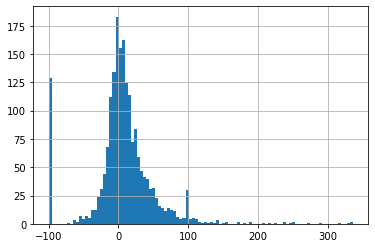

In [14]:
combined['value_change'].loc[combined['value_change']<500].hist(bins=100)

In [63]:
combined['income_change'].loc[combined['income_change']<500].hist(bins=100)

KeyError: 'income_change'

In [64]:
combined['rent_change'].loc[combined['rent_change']<500].hist(bins=100)

KeyError: 'rent_change'

# Combine Data For Corelation

In [65]:
path = '/Users/Kahty/Location Research/data/rtlchange_tract/rtlchange.shp'
gdf = gpd.read_file(path)

In [66]:
combinedvalue = gdf.merge(df, left_on='GEOID', right_on='GEO_ID')
combinedvalue = combinedvalue.drop(columns=['GEO_ID'])
combinedvalue

,OBJECTID,CTLabel,BoroCode,BoroName,CT2010,BoroCT2010,CDEligibil,NTACode,NTAName,PUMA,...,geometry,Value Median 2010,Household Income Median 2010,Rent Median 2010,Value Median 2017,Household Income Median 2017,Rent Median 2017,value_change,income_change,rent_change
0,1,9,5,Staten Island,900,5000900,E,SI22,West New Brighton-New Brighton-St. George,3903,...,"POLYGON ((-74.07921 40.64344, -74.07914 40.643...",483100,151806,620,398200,98333,1215,-17.574001,-35.224563,95.967742
1,2,98,1,Manhattan,9800,1009800,I,MN19,Turtle Bay-East Midtown,3808,...,"POLYGON ((-73.96433 40.75639, -73.96479 40.755...",766500,152788,488,1139500,250000,2527,48.662753,63.625416,417.827869
2,3,102,1,Manhattan,10200,1010200,I,MN17,Midtown-Midtown South,3807,...,"POLYGON ((-73.97124 40.76094, -73.97170 40.760...",57500,41283,774,0,138438,3500,-100.000000,235.339002,352.196382
3,4,104,1,Manhattan,10400,1010400,I,MN17,Midtown-Midtown South,3807,...,"POLYGON ((-73.97446 40.76230, -73.97492 40.761...",1000000,121326,582,640600,182778,2661,-35.940000,50.650314,357.216495
4,5,113,1,Manhattan,11300,1011300,I,MN17,Midtown-Midtown South,3807,...,"POLYGON ((-73.98412 40.75485, -73.98460 40.754...",0,0,513,0,76250,3021,NaN,NaN,488.888889
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2160,2161,48,1,Manhattan,4800,1004800,I,MN21,Gramercy,3808,...,"POLYGON ((-73.98021 40.73439, -73.98038 40.734...",657100,140324,1019,842700,192461,1936,28.245320,37.154728,89.990186
2161,2162,506,3,Brooklyn,50600,3050600,E,BK42,Flatbush,4015,...,"POLYGON ((-73.96219 40.64980, -73.96308 40.649...",738200,113831,596,757500,140583,1536,2.614468,23.501507,157.718121
2162,2163,508.01,3,Brooklyn,50801,3050801,E,BK42,Flatbush,4015,...,"POLYGON ((-73.95871 40.65040, -73.95998 40.650...",0,0,833,0,0,1358,NaN,NaN,63.025210
2163,2164,157,1,Manhattan,15700,1015700,I,MN14,Lincoln Square,3806,...,"POLYGON ((-73.97500 40.77754, -73.97546 40.776...",959800,237917,972,1082700,226728,2166,12.804751,-4.702901,122.839506


In [67]:
combinedvalue = combinedvalue.rename(columns={'density_ch': 'retail density_change%'})
combinedvalue = combinedvalue.rename(columns={'count_chan': 'retail number_change%'})
combinedvalue = combinedvalue.rename(columns={'value_change': 'valuation_change%'})
combinedvalue = combinedvalue.rename(columns={'income_change': 'income_change%'})
combinedvalue = combinedvalue.rename(columns={'rent_change': 'rent_change%'})

# Commercial Zone

In [68]:
combined = combinedvalue

In [69]:
path = '/Users/Kahty/Location Research/data/cct.csv'
cct = pd.read_csv(path)
cct

,GEOID,c
0,36005000200,0
1,36005000400,0
2,36005001600,0
3,36005001900,0
4,36005002000,0
...,...,...
2150,36085030301,0
2151,36085030302,0
2152,36085031901,2
2153,36085031902,0


In [70]:
temp = combined.merge(cct, left_on='GEOID', right_on='GEOID')
combined = temp
combined.drop(combined[combined['c']==0 ].index, inplace=True)
combined

,OBJECTID,CTLabel,BoroCode,BoroName,CT2010,BoroCT2010,CDEligibil,NTACode,NTAName,PUMA,...,Value Median 2010,Household Income Median 2010,Rent Median 2010,Value Median 2017,Household Income Median 2017,Rent Median 2017,valuation_change%,income_change%,rent_change%,c
1,2,98,1,Manhattan,9800,1009800,I,MN19,Turtle Bay-East Midtown,3808,...,766500,152788,488,1139500,250000,2527,48.662753,63.625416,417.827869,74
2,3,102,1,Manhattan,10200,1010200,I,MN17,Midtown-Midtown South,3807,...,57500,41283,774,0,138438,3500,-100.000000,235.339002,352.196382,98
3,4,104,1,Manhattan,10400,1010400,I,MN17,Midtown-Midtown South,3807,...,1000000,121326,582,640600,182778,2661,-35.940000,50.650314,357.216495,110
4,5,113,1,Manhattan,11300,1011300,I,MN17,Midtown-Midtown South,3807,...,0,0,513,0,76250,3021,NaN,NaN,488.888889,49
5,6,114.02,1,Manhattan,11402,1011402,I,MN40,Upper East Side-Carnegie Hill,3805,...,1000000,207375,736,1520000,250000,2073,52.000000,20.554551,181.657609,69
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2137,2148,151,1,Manhattan,15100,1015100,I,MN14,Lincoln Square,3806,...,1000000,250000,1074,2000000,250000,1072,100.000000,0.000000,-0.186220,18
2150,2161,48,1,Manhattan,4800,1004800,I,MN21,Gramercy,3808,...,657100,140324,1019,842700,192461,1936,28.245320,37.154728,89.990186,72
2152,2163,508.01,3,Brooklyn,50801,3050801,E,BK42,Flatbush,4015,...,0,0,833,0,0,1358,NaN,NaN,63.025210,3
2153,2164,157,1,Manhattan,15700,1015700,I,MN14,Lincoln Square,3806,...,959800,237917,972,1082700,226728,2166,12.804751,-4.702901,122.839506,94


# Interactive 1

In [79]:
combined['folium_valuation_change'] = combined['valuation_change%'].clip(-100, 100)

In [80]:
import requests
import os
import geopandas as gpd
import pandas as pd
import numpy as np
from shapely import wkt
from shapely.geometry import Point
import matplotlib.pyplot as plt
import folium

In [81]:
style_fnc = lambda x: {'fillColor': '#ffffff',
                       'color':'#000000',
                       'fillOpacity': 0.1,
                       'weight': 0.1}
highlight_fnc = lambda x: {'fillColor': '#000000',
                           'color':'#000000',
                           'fillOpacity': 0.50,
                           'weight': 0.1}

In [82]:
x = combined.centroid.x.mean()
y = combined.centroid.y.mean()
f_map = folium.Map(location=[y, x], zoom_start=11, tiles='cartodbpositron')

#改底图https://python-visualization.github.io/folium/

<ipython-input-82-2c01e7c9f156>:1: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.


<ipython-input-82-2c01e7c9f156>:2: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.




In [83]:
folium.Choropleth(
    geo_data=combined,
    data=combined,
    columns=['GEOID', 'folium_valuation_change'],
    key_on='feature.properties.GEOID',
    fill_color='RdYlGn',
    fill_opacity=0.8,
    line_opacity=0.05,
    nan_fill_color='white',
    nan_fill_opacity=0,
    legend_name='Percentage change of median property value (%)',
    bins=[-100,-80,-60,-40,-20,0., 20, 40, 60, 80, 100]
).add_to(f_map)

In [84]:
interact = folium.features.GeoJson(
    combined,
    style_function=style_fnc,
    control=False,
    highlight_function=highlight_fnc,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['GEOID', 'folium_valuation_change'],
        aliases=['Census Tract: ','Percentage change of median property value (%): '],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;")
    )
)
f_map.add_child(interact)
f_map.keep_in_front(interact)
folium.LayerControl().add_to(f_map)
f_map

In [85]:
#f_map.save("map4_value_change.html")

# Interactive 2

In [22]:
import requests
import os
import geopandas as gpd
import pandas as pd
import numpy as np
from shapely import wkt
from shapely.geometry import Point
import matplotlib.pyplot as plt
import folium

In [23]:
combinedvalue['folium_valuation_change'] = combinedvalue['valuation_change%'].clip(-100, 100)
combinedvalue

,OBJECTID,CTLabel,BoroCode,BoroName,CT2010,BoroCT2010,CDEligibil,NTACode,NTAName,PUMA,...,Value Median 2010,Household Income Median 2010,Rent Median 2010,Value Median 2017,Household Income Median 2017,Rent Median 2017,valuation_change%,income_change%,rent_change%,folium_valuation_change
0,1,9,5,Staten Island,900,5000900,E,SI22,West New Brighton-New Brighton-St. George,3903,...,483100,151806,620,398200,98333,1215,-17.574001,-35.224563,95.967742,-17.574001
1,2,98,1,Manhattan,9800,1009800,I,MN19,Turtle Bay-East Midtown,3808,...,766500,152788,488,1139500,250000,2527,48.662753,63.625416,417.827869,48.662753
2,3,102,1,Manhattan,10200,1010200,I,MN17,Midtown-Midtown South,3807,...,57500,41283,774,0,138438,3500,-100.000000,235.339002,352.196382,-100.000000
3,4,104,1,Manhattan,10400,1010400,I,MN17,Midtown-Midtown South,3807,...,1000000,121326,582,640600,182778,2661,-35.940000,50.650314,357.216495,-35.940000
4,5,113,1,Manhattan,11300,1011300,I,MN17,Midtown-Midtown South,3807,...,0,0,513,0,76250,3021,NaN,NaN,488.888889,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2160,2161,48,1,Manhattan,4800,1004800,I,MN21,Gramercy,3808,...,657100,140324,1019,842700,192461,1936,28.245320,37.154728,89.990186,28.245320
2161,2162,506,3,Brooklyn,50600,3050600,E,BK42,Flatbush,4015,...,738200,113831,596,757500,140583,1536,2.614468,23.501507,157.718121,2.614468
2162,2163,508.01,3,Brooklyn,50801,3050801,E,BK42,Flatbush,4015,...,0,0,833,0,0,1358,NaN,NaN,63.025210,NaN
2163,2164,157,1,Manhattan,15700,1015700,I,MN14,Lincoln Square,3806,...,959800,237917,972,1082700,226728,2166,12.804751,-4.702901,122.839506,12.804751


In [24]:

style_fnc = lambda x: {'fillColor': '#ffffff',
                       'color':'#000000',
                       'fillOpacity': 0.1,
                       'weight': 0.1}
highlight_fnc = lambda x: {'fillColor': '#000000',
                           'color':'#000000',
                           'fillOpacity': 0.50,
                           'weight': 0.1}

In [25]:
x = combinedvalue.centroid.x.mean()
y = combinedvalue.centroid.y.mean()
f_map = folium.Map(location=[y, x], zoom_start=11, tiles='cartodbpositron')

#改底图https://python-visualization.github.io/folium/

<ipython-input-25-a4fd9a9cfb83>:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  x = combinedvalue.centroid.x.mean()
<ipython-input-25-a4fd9a9cfb83>:2: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  y = combinedvalue.centroid.y.mean()


In [26]:
folium.Choropleth(
    geo_data=combinedvalue,
    data=combinedvalue,
    columns=['GEOID', 'folium_valuation_change'],
    key_on='feature.properties.GEOID',
    fill_color='RdYlBu',
    fill_opacity=0.8,
    line_opacity=0.05,
    nan_fill_color='white',
    nan_fill_opacity=0,
    legend_name='Percentage change of median property valuation (%)',
    bins=[-100,-80,-60,-40,-20,0., 20, 40, 60, 80, 100]
).add_to(f_map)

In [27]:
interact = folium.features.GeoJson(
    combinedvalue,
    style_function=style_fnc,
    control=False,
    highlight_function=highlight_fnc,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['GEOID', 'folium_valuation_change'],
        aliases=['Census Tract: ','Percentage change of median property valuation (%): '],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;")
    )
)
f_map.add_child(interact)
f_map.keep_in_front(interact)
folium.LayerControl().add_to(f_map)
f_map

In [28]:
#f_map.save("map4_value_change.html")

# OLS Regression 1

In [99]:
import os
import pandas as pd
import numpy as np
from sodapy import Socrata
import plotly.express as px
import plotly.graph_objects as go

In [100]:
combined.drop(combined[combined['retail number_change%'] >100 ].index, inplace=True)
combined.drop(combined[combined['valuation_change%'] >200 ].index, inplace=True)

In [113]:
fig=go.Figure()

fig=px.scatter(combined, x='valuation_change%', y='retail number_change%',trendline="ols",color="BoroName")

fig.update_layout(
    title='Linear Regression Between Median Property Value Change & Retail Number Change, by Census Tract, 2009 & 2017',
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    font_color ='white',
     xaxis=dict(
        title='median property value change (%)'),
    yaxis=dict(
        title='retail number change (%)')
)


fig.update_xaxes(showgrid=False, zeroline=False)
fig.update_yaxes(showgrid=False, zeroline=False)

fig.show()

In [114]:
fig.write_html("regression_number_value.html")

In [115]:
combined.drop(combined[combined['retail density_change%'] >100 ].index, inplace=True)
combined.drop(combined[combined['valuation_change%'] >200 ].index, inplace=True)
combined.drop(combined[combined['valuation_change%'] ==-100 ].index, inplace=True)

fig=go.Figure()

fig=px.scatter(combined, x='valuation_change%', y='retail density_change%',trendline="ols",color="BoroName")

fig.update_layout(
    title='Linear Regression Between Property Valuation Change & Retail Percap Density Change, by Census Tract, 2009 & 2017',
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    font_color ='white',
     xaxis=dict(
        title='property valuation change (%)'),
    yaxis=dict(
        title='retail percap density change (%)')
)


fig.update_xaxes(showgrid=False, zeroline=False)
fig.update_yaxes(showgrid=False, zeroline=False)

fig.show()

In [116]:
fig.write_html("regression_density_value.html")

# OLS Regression 2

In [29]:
import os
import pandas as pd
import numpy as np
from sodapy import Socrata
import plotly.express as px
import plotly.graph_objects as go

In [30]:
combinedvalue.drop( combinedvalue[combinedvalue['retail number_change%'] >100 ].index, inplace=True)
combinedvalue.drop( combinedvalue[combinedvalue['valuation_change%'] >200 ].index, inplace=True)

In [31]:
fig=go.Figure()

fig=px.scatter(combinedvalue, x='valuation_change%', y='retail number_change%',trendline="ols",color="BoroName")

fig.update_layout(
    title='Linear Regression Between Retail Number Change & Median Property Value Change, by Census Tract, 2009 & 2017',
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    font_color ='white',
     xaxis=dict(
        title='median property value change (%)'),
    yaxis=dict(
        title='retail number change (%)')
)


fig.update_xaxes(showgrid=False, zeroline=False)
fig.update_yaxes(showgrid=False, zeroline=False)

fig.show()

In [32]:
#fig.write_html("regression_number_value.html")

In [33]:
combinedvalue.drop( combinedvalue[combinedvalue['retail density_change%'] >100 ].index, inplace=True)
combinedvalue.drop( combinedvalue[combinedvalue['valuation_change%'] >200 ].index, inplace=True)

In [34]:
fig=go.Figure()

fig=px.scatter(combinedvalue, x='valuation_change%', y='retail density_change%',trendline="ols",color="BoroName")

fig.update_layout(
    title='Linear Regression Between Retail Percap Density Change & Property Valuation Change, by Census Tract, 2009 & 2017',
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    font_color ='white',
     xaxis=dict(
        title='property valuation change (%)'),
    yaxis=dict(
        title='retail percap density change (%)')
)


fig.update_xaxes(showgrid=False, zeroline=False)
fig.update_yaxes(showgrid=False, zeroline=False)

fig.show()

In [35]:
#fig.write_html("regression_density_value.html")